### Importing Libraries

In [1]:
# import drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import librosa
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.image import resize

In [3]:
#Loading Model
model = tf.keras.models.load_model("./drive/MyDrive/ML_Project/GenHive_model.h5")

In [4]:
classes = ['alternative_indie', 'edm','jpop','kpop','pop','rnb','rock','trap_hip-hop']

### Single Audio Preprocessing

In [5]:
import librosa
import numpy as np
from skimage.transform import resize

def load_and_preprocess_data(file_path, target_shape=(150, 150)):
    data = []
    audio_data, sample_rate = librosa.load(file_path, sr=None)
    # Perform preprocessing (e.g., convert to Mel spectrogram and resize)
    # Define the duration of each chunk and overlap
    chunk_duration = 4  # seconds
    overlap_duration = 2  # seconds

    # Convert durations to samples
    chunk_samples = chunk_duration * sample_rate
    overlap_samples = overlap_duration * sample_rate

    # Calculate the number of chunks
    num_chunks = int(np.ceil((len(audio_data) - chunk_samples)
                             / (chunk_samples - overlap_samples))) + 1

    # Iterate over each chunk
    for i in range(num_chunks):
        start = i * (chunk_samples - overlap_samples)
        end = start + chunk_samples

        chunk = audio_data[start:end]

        mel_spectrogram = librosa.feature.melspectrogram(y=chunk, sr=sample_rate)

        mel_spectrogram = resize(np.expand_dims(mel_spectrogram, axis=-1), target_shape)
        data.append(mel_spectrogram)

    return np.array(data)

### Playing a sound

In [6]:
from IPython.display import Audio
file_path = "./drive/MyDrive/ML_Project/Tenxi, Naykilla _ Jemsii - Garam _ Madu (Sakit Dadaku) (Official Music Video).mp3"
y, sr = librosa.load(file_path, sr=44100)
Audio(data=y, rate=sr)

In [7]:
#Processing Test File
X_test = load_and_preprocess_data(file_path)

### Model Prediction

In [8]:
#Model Prediction
def model_prediction(X_test):
    y_pred = model.predict(X_test)
    predicted_categories = np.argmax(y_pred,axis=1)
    unique_elements, counts = np.unique(predicted_categories, return_counts=True)
    #print(unique_elements, counts)
    max_count = np.max(counts)
    max_elements = unique_elements[counts == max_count]
    return max_elements[0]

In [9]:
#Model Prediction
c_index = model_prediction(X_test)
print(f"Model Prediction :: Music Genre --> {classes[c_index]}")

3/3 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step
Model Prediction :: Music Genre --> rnb


In [10]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import librosa
import librosa.display
import matplotlib.pyplot as plt

def predict_audio(file_path, model, classes):
    y, sr = librosa.load(file_path, sr=None)
    mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
    mel_spectrogram = tf.image.resize(np.expand_dims(mel_spectrogram, axis=-1), (150, 150))
    mel_spectrogram = np.expand_dims(mel_spectrogram, axis=0)  # Add batch dimension

    predictions = model.predict(mel_spectrogram)[0]  # Get prediction probabilities

    # Menampilkan hasil prediksi dengan persentase
    print("Predicted Genre Probabilities:")
    for genre, prob in zip(classes, predictions):
        print(f"{genre}: {prob * 100:.2f}%")

    # Menentukan genre dengan probabilitas tertinggi
    predicted_genre = classes[np.argmax(predictions)]
    print(f"Predicted Genre: {predicted_genre}")
    return predicted_genre

# Load trained model
model_path = "./drive/MyDrive/ML_Project/GenHive_model.h5"
model = load_model(model_path)

# Define genre classes
classes = ['alternative_indie', 'edm', 'jpop', 'kpop', 'pop', 'rnb', 'rock', 'trap_hip-hop']

# Example usage
audio_file = "./drive/MyDrive/ML_Project/Tenxi, Naykilla _ Jemsii - Garam _ Madu (Sakit Dadaku) (Official Music Video).mp3"
predict_audio(audio_file, model, classes)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
Predicted Genre Probabilities:
alternative_indie: 0.01%
edm: 0.00%
jpop: 1.64%
kpop: 0.00%
pop: 98.35%
rnb: 0.00%
rock: 0.00%
trap_hip-hop: 0.00%
Predicted Genre: pop


'pop'

In [11]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import librosa

def predict_audio(file_path, model, classes):
    y, sr = librosa.load(file_path, sr=None)
    mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
    mel_spectrogram = tf.image.resize(np.expand_dims(mel_spectrogram, axis=-1), (150, 150))
    mel_spectrogram = np.expand_dims(mel_spectrogram, axis=0)  # Add batch dimension

    predictions = model.predict(mel_spectrogram)[0]  # Get prediction probabilities
    predicted_genre = classes[np.argmax(predictions)]
    return predicted_genre, predictions

# Load trained models
model_path1 = "./drive/MyDrive/ML_Project/GenHive_model.h5"
model_path2 = "./drive/MyDrive/ML_Project/Trained_model.h5"
model1 = load_model(model_path1)
model2 = load_model(model_path2)

# Define genre classes
classes_new = ['alternative_indie', 'edm', 'jpop', 'kpop', 'pop', 'rnb', 'rock', 'trap_hip-hop']
classes_old = ['blues', 'classical','country','disco','hiphop','jazz','metal','pop','reggae','rock']

# Directory containing audio files
audio_folder = "./drive/MyDrive/ML_Project/audio_files/ROCK TEST/"

# Initialize counters
correct_model1 = 0
incorrect_model1 = 0
correct_model2 = 0
incorrect_model2 = 0
file_count = 0

# Loop through all audio files in the folder
for audio_file in os.listdir(audio_folder):
    if audio_file.endswith(".wav"):
        audio_path = os.path.join(audio_folder, audio_file)
        actual_class1 = "rock"  # Replace with actual class if known
        actual_class2 = "rock"  # Replace with actual class if known
        file_count += 1

        # Predict with both models
        predicted_genre1, probabilities1 = predict_audio(audio_path, model1, classes_new)
        predicted_genre2, probabilities2 = predict_audio(audio_path, model2, classes_old)

        # Print comparison
        print(f"File: {audio_file}")
        print("Actual Genre:", actual_class1)
        print("Model 1 Prediction:", predicted_genre1)
        print("Model 2 Prediction:", predicted_genre2)

        if predicted_genre1 == actual_class1:
            correct_model1 += 1
            print("Model 1 is correct!")
        else:
            incorrect_model1 += 1
            print("Model 1 is incorrect.")

        if predicted_genre2 == actual_class2:
            correct_model2 += 1
            print("Model 2 is correct!")
        else:
            incorrect_model2 += 1
            print("Model 2 is incorrect.")
        print("-" * 50)

# Calculate accuracy
accuracy_model1 = (correct_model1 / file_count) * 100 if file_count > 0 else 0
accuracy_model2 = (correct_model2 / file_count) * 100 if file_count > 0 else 0

# Print final results
print("Final Results:")
print(f"Model 1: {correct_model1} correct, {incorrect_model1} incorrect, Accuracy: {accuracy_model1:.2f}%")
print(f"Model 2: {correct_model2} correct, {incorrect_model2} incorrect, Accuracy: {accuracy_model2:.2f}%")


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/optimizers/base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
File: Test-Rock.wav
Actual Genre: rock
Model 1 Prediction: rock
Model 2 Prediction: metal
Model 1 is correct!
Model 2 is incorrect.
--------------------------------------------------
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
File: Test-Rock 1-OZZY OSBOURNE - ＂Dreamer＂ (Official Video).wav
Actual Genre: rock
Model 1 Prediction: alternative_indie
Model 2 Prediction: blues
Model 1 is incorrect.
Model 2 is incorrect.
--------------------------------------------------
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
File: Test-Rock 2-Lost [Official Music Video] - Linkin Park.wav
Actual Genre: rock
Model 1 Prediction: pop
Model 2 Prediction: reggae
Model 1 is incorrect.
Model 2 is incorrect.
--------------------------------------------------
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
File: Test-Rock 7-Electric Light Orchestra - Last Train to London (Offici

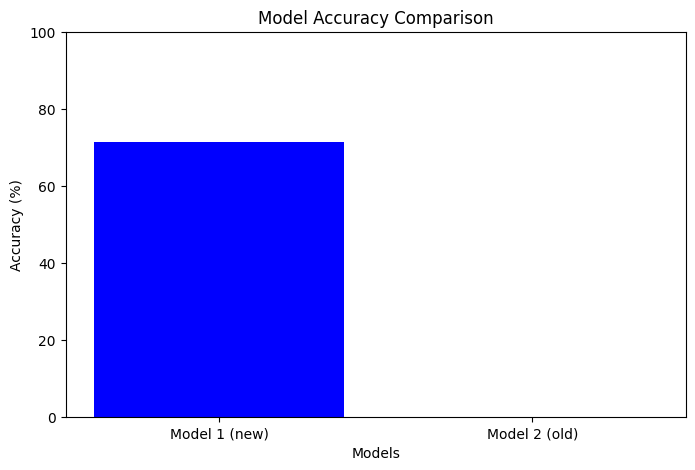

In [12]:
import matplotlib.pyplot as plt

models = ['Model 1 (new)', 'Model 2 (old)']
accuracies = [accuracy_model1, accuracy_model2]
plt.figure(figsize=(8,5))
plt.bar(models, accuracies, color=['blue', 'green'])
plt.xlabel("Models")
plt.ylabel("Accuracy (%)")
plt.title("Model Accuracy Comparison")
plt.ylim(0, 100)
plt.show()